# Метрики

**CLIP-I** - среднее попарное косинусное сходство между сгенерированными и настоящими картинкой в латентном пространстве эмбеддингов модели CLIP

**CLIP-T** - среднее косинусное сходство между сгенерированными картинками и базовым промптом в пространстве модели CLIP

**G-R** - среднее косинусное сходство между сгенерированными картинками и контекстными промптами в пространстве модели CLIP

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

sns.set_theme(style="whitegrid", palette=sns.color_palette("Set2"))

In [5]:
# Load the example diamonds dataset
data = pd.read_excel('metrics_lora.xlsx')

def label_point(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x'], point['y'], str(point['val']))
        
data.head()

,Concept,Rank,CLIP-T,CLIP-I,G-R,Method
0,dog,4,0.248347,0.931003,0.877386,LoRA
1,backpack,4,0.242530,0.857648,0.857648,LoRA
2,cat,4,0.259069,0.844742,0.844742,LoRA
3,dog,8,0.251001,0.936219,0.878128,LoRA
4,backpack,8,0.233588,0.892371,0.858141,LoRA


## Все концепты

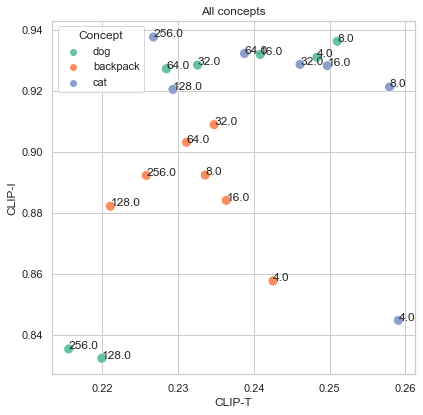

In [3]:
# Draw a scatter plot while assigning point colors and sizes to different
# variables in the dataset
f, ax = plt.subplots(figsize=(6.5, 6.5))

sns.scatterplot(x="CLIP-T", y="CLIP-I",
                hue="Concept",
                data=data, ax=ax,
                s=100).set(title='All concepts')

label_point(data["CLIP-T"], data["CLIP-I"], data["Rank"], plt.gca())

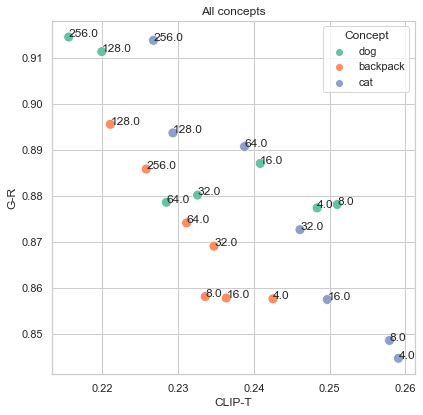

In [8]:
f, ax = plt.subplots(figsize=(6.5, 6.5))

sns.scatterplot(x="CLIP-T", y="G-R",
                hue="Concept",
                data=data, ax=ax,
                s=100).set(title='All concepts')

label_point(data["CLIP-T"], data["G-R"], data["Rank"], plt.gca())

## Отдельно по концептам

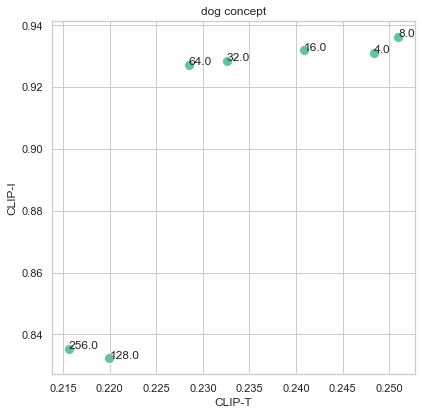

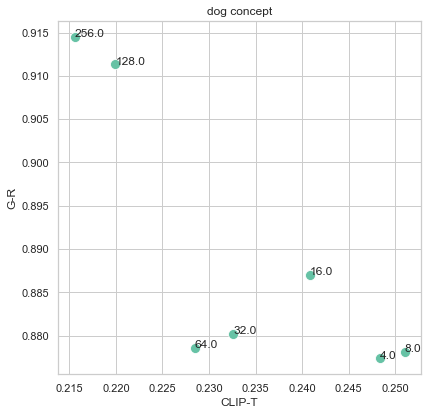

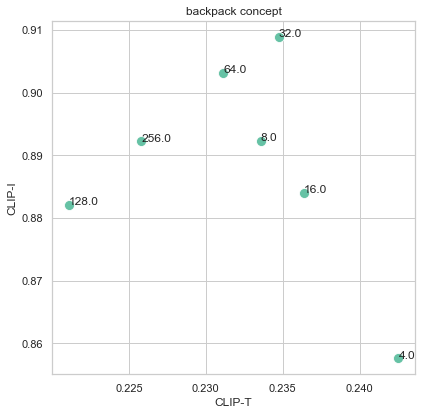

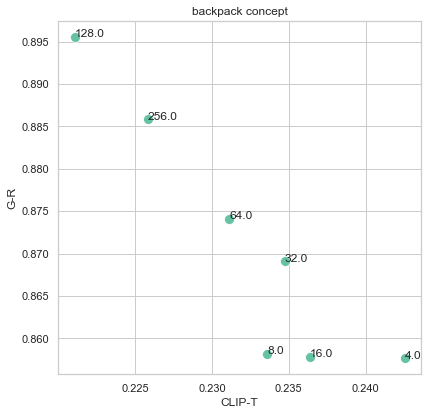

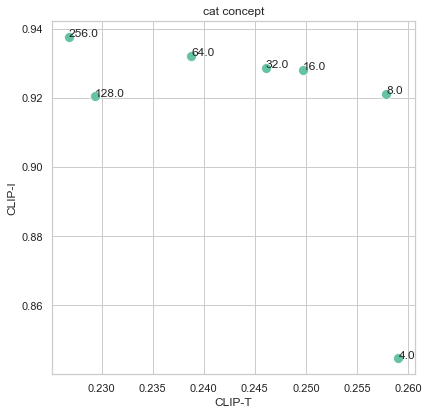

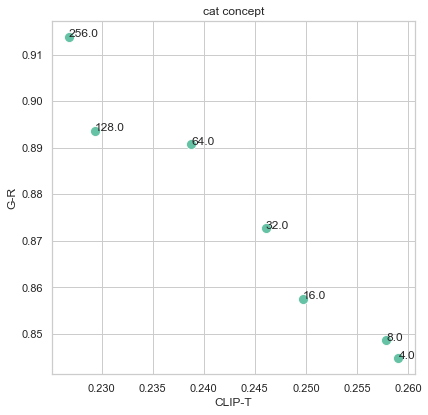

In [7]:
for concept in data["Concept"].unique():
    f, ax = plt.subplots(figsize=(6.5, 6.5))
    
    concept_data = data[data["Concept"] == concept]
    sns.scatterplot(x="CLIP-T", y="CLIP-I",
                data=concept_data, ax=ax,
                s=100).set(title=f'{concept} concept')
    label_point(concept_data["CLIP-T"], concept_data["CLIP-I"], concept_data["Rank"], plt.gca())

    f, ax = plt.subplots(figsize=(6.5, 6.5))
    sns.scatterplot(x="CLIP-T", y="G-R",
                data=concept_data, ax=ax,
                s=100).set(title=f'{concept} concept')
    label_point(concept_data["CLIP-T"], concept_data["G-R"], concept_data["Rank"], plt.gca())


# Примеры сгенерированных изображений

In [6]:
from glob import glob
import random
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os

from mpl_toolkits.axes_grid1 import ImageGrid

def get_examples(prompts_path):
    images_with_prompts = []
    last_prompt = ''
    for prompts_file in glob(prompts_path + '/*.txt'):
        filename, ext = os.path.basename(prompts_file).split('.')
        prompt = filename.split('_')[0]
        if prompt == last_prompt:
            continue

        n_gen_images = len(glob(f'{prompts_path}/{prompt}*.png'))
        id_image = random.randint(0, n_gen_images - 1)

        img = Image.open(f'{prompts_path}/{prompt}_{id_image}.png')
        
        images_with_prompts.append((prompt, img))
        
        last_prompt = prompt
    return images_with_prompts
    
def draw_examples(images_with_prompts):
    fig = plt.figure(figsize=(25., 25.))
    grid = ImageGrid(fig, 111,  # similar to subplot(111)
                     nrows_ncols=(5, 5),
                     axes_pad=1
                     )

    for ax, im in zip(grid, images_with_prompts):
        ax.imshow(im[1])
        ax.set_title(im[0])
        ax.grid(False)

    plt.show()

### LoRA

Concept: dog6

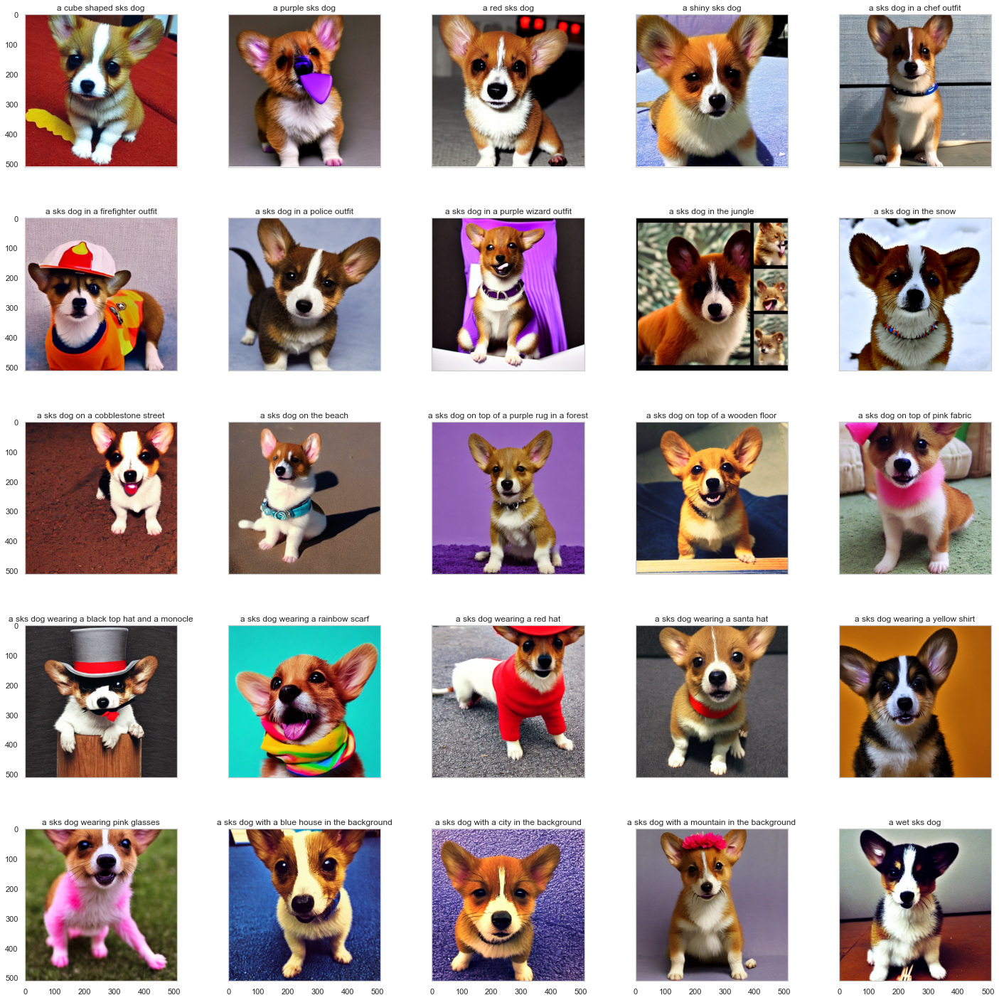

In [7]:
examples = get_examples('../inference/generated_images/dog/t2i/textual_inversion')
draw_examples(examples)

Concept: backpack

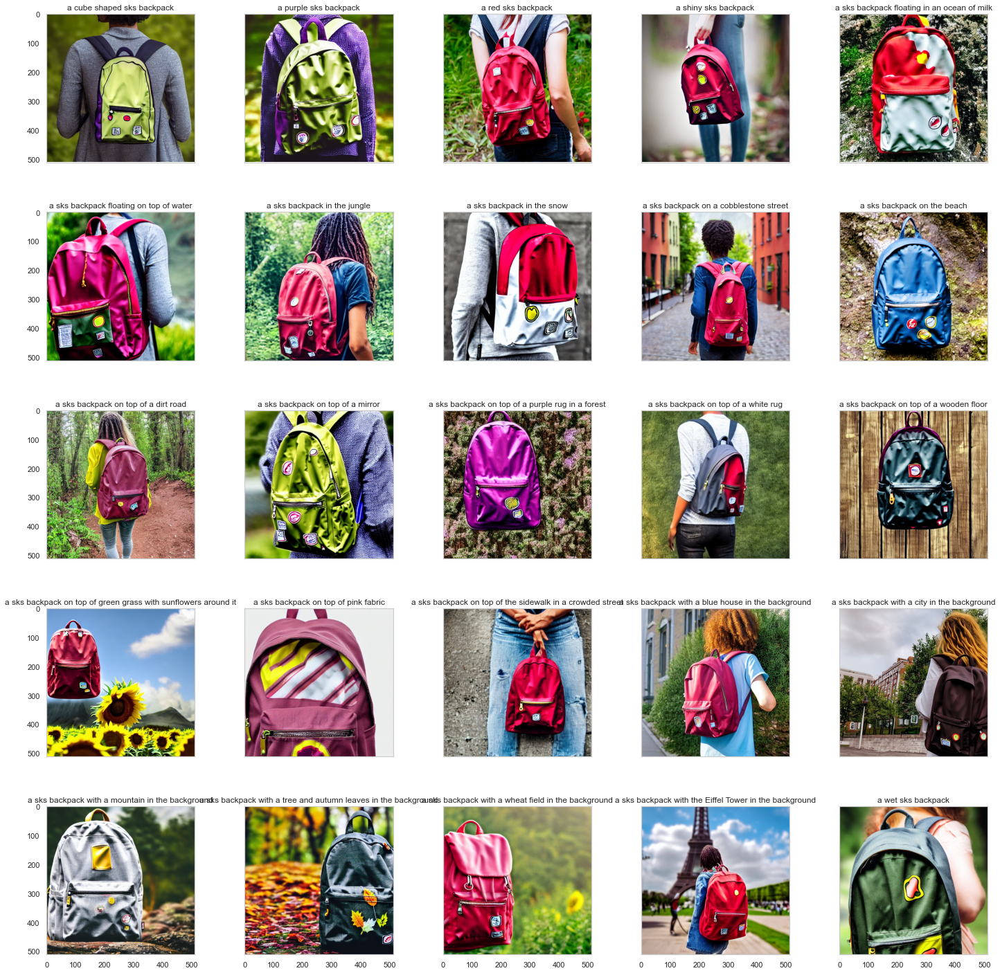

In [8]:
examples = get_examples('../inference/generated_images/backpack/t2i/textual_inversion')
draw_examples(examples)

Concept: cat

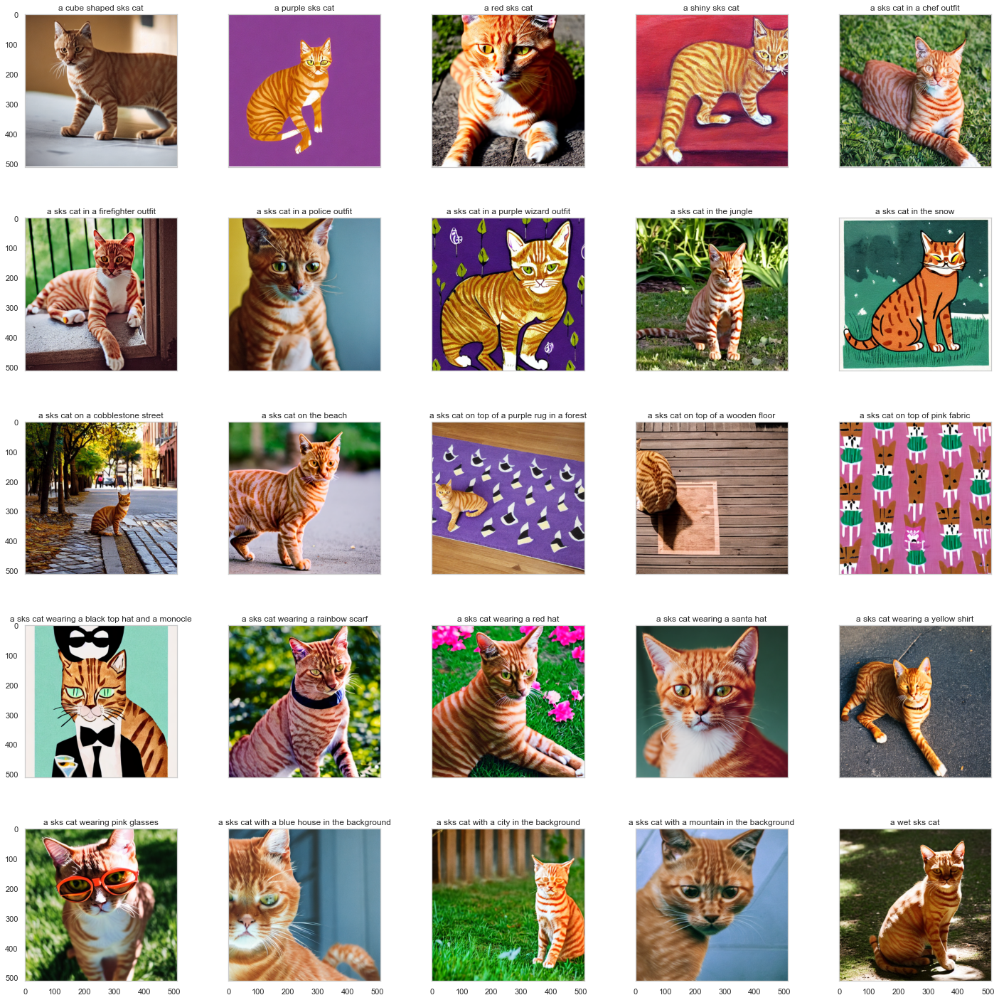

In [9]:
examples = get_examples('../inference/generated_images/cat/t2i/textual_inversion')
draw_examples(examples)

### Dreambooth

Concept: dog6

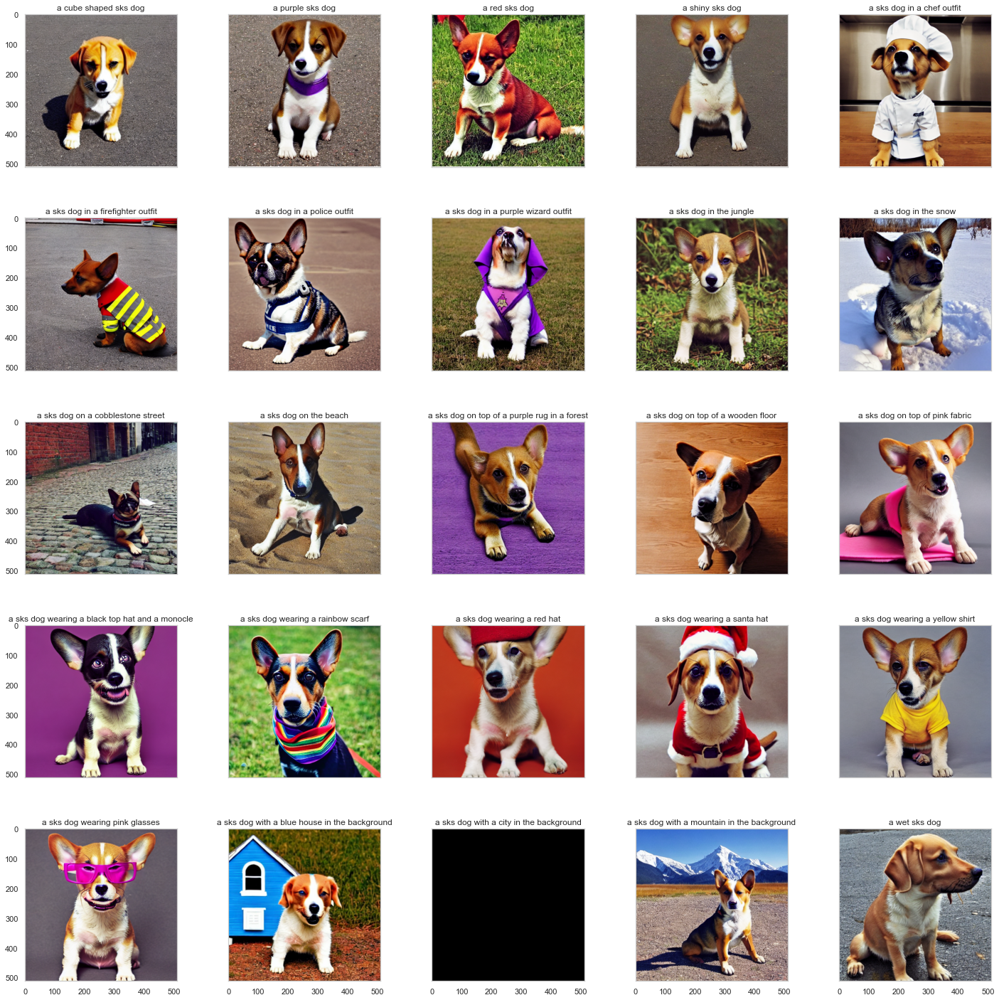

In [10]:
examples = get_examples('../inference/generated_images/dog/t2i/dreambooth')
draw_examples(examples)

Concept: backpack

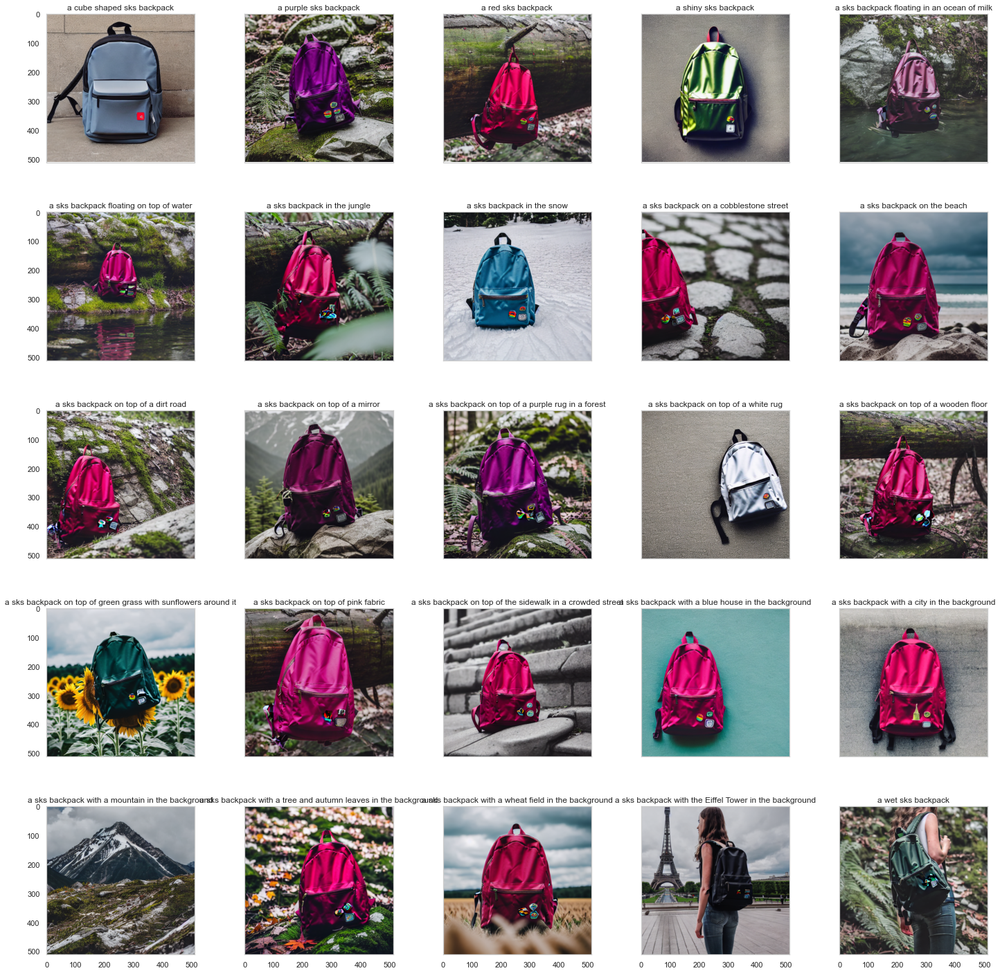

In [11]:
examples = get_examples('../inference/generated_images/backpack/t2i/dreambooth')
draw_examples(examples)

Concept: cat

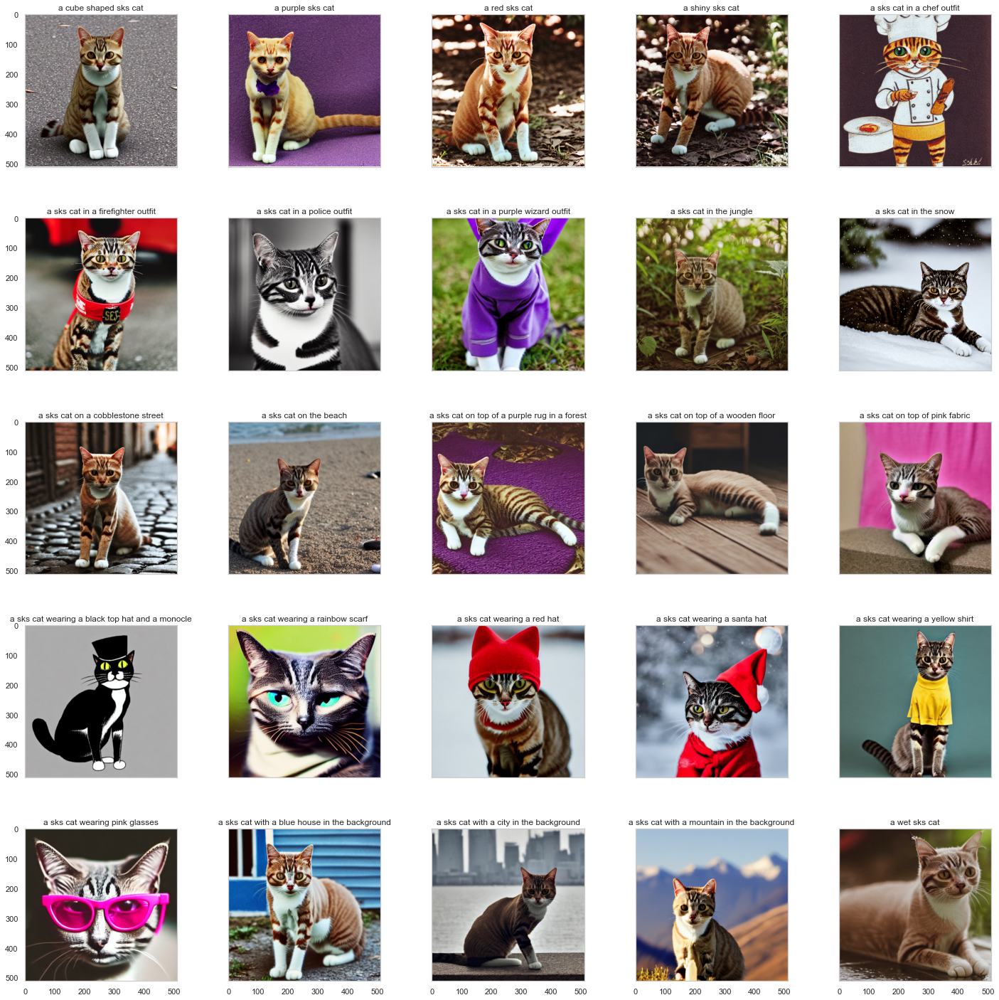

In [12]:
examples = get_examples('../inference/generated_images/cat/t2i/dreambooth')
draw_examples(examples)

### LoRA

Concept: dog6

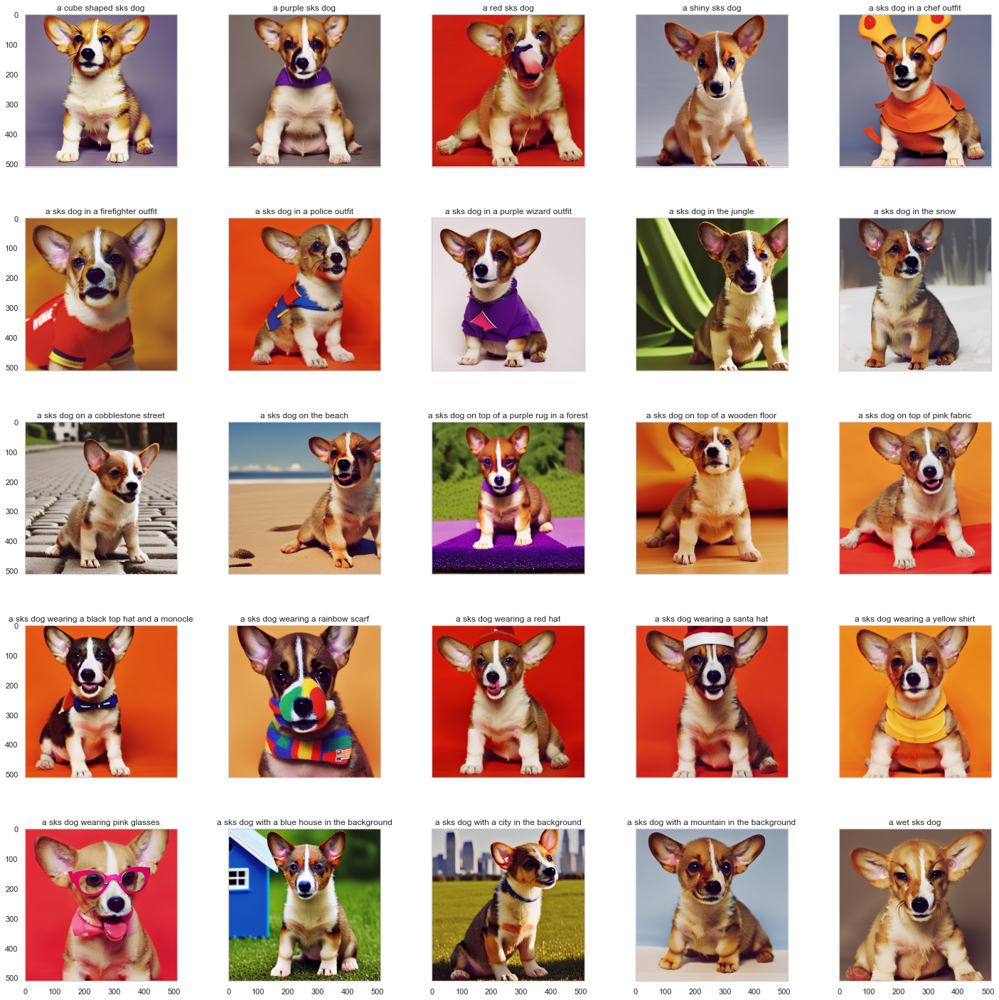

In [13]:
examples = get_examples('../inference/generated_images/dog/t2i/lora')
draw_examples(examples)

Concept: backpack

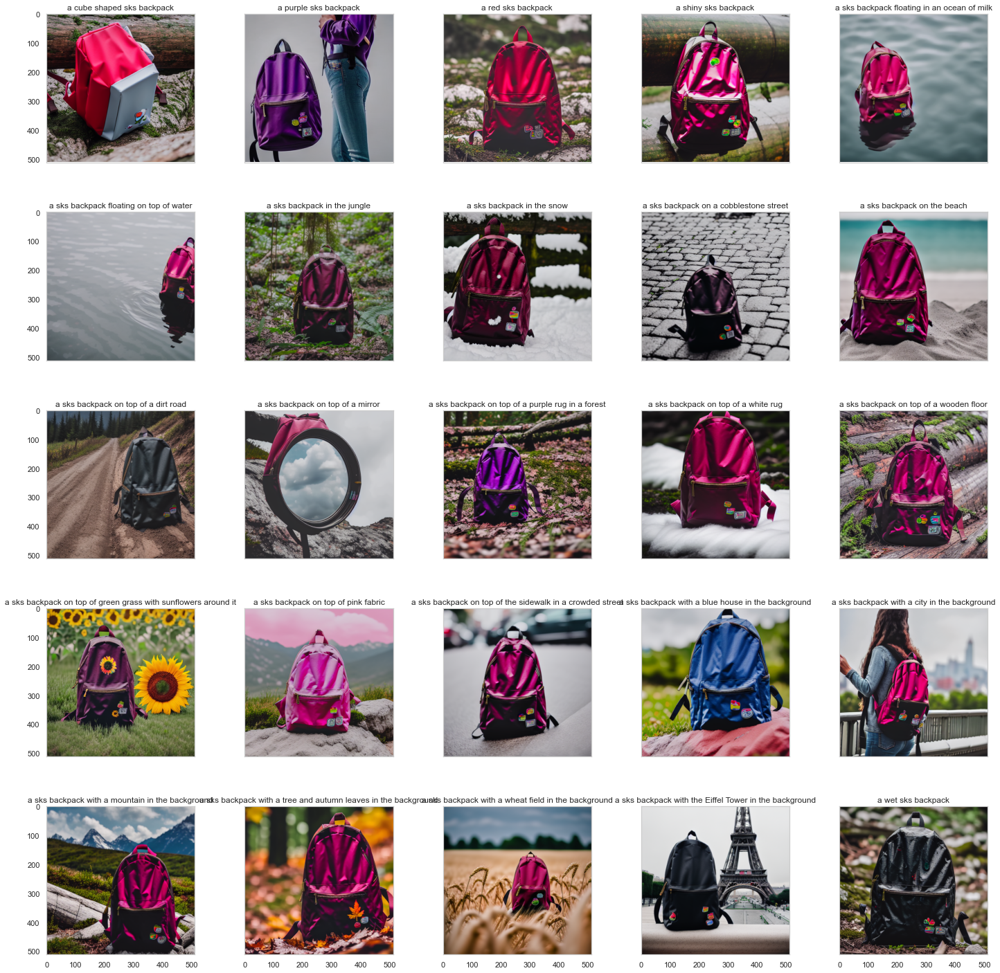

In [14]:
examples = get_examples('../inference/generated_images/backpack/t2i/lora')
draw_examples(examples)

Concept: cat

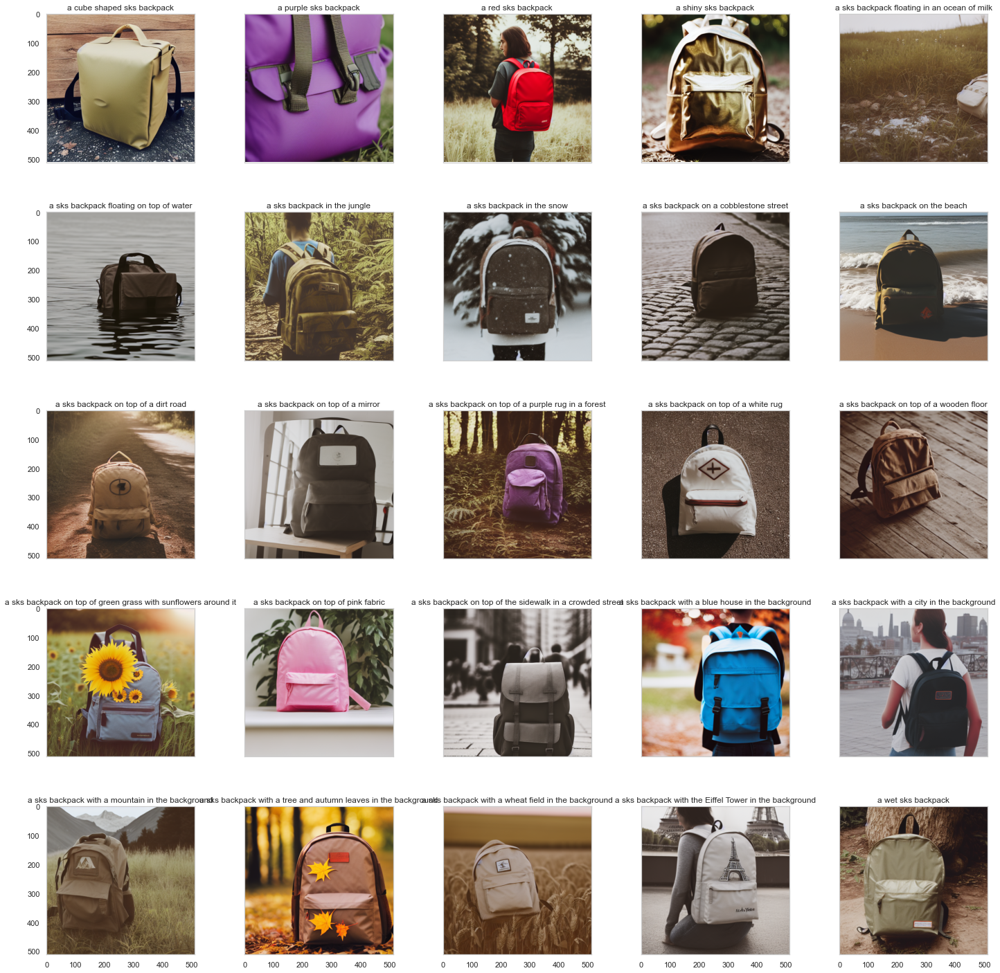

In [15]:
examples = get_examples('../inference/generated_images/cat/t2i/lora')
draw_examples(examples)

### Custom Diffusion

Concept: dog6

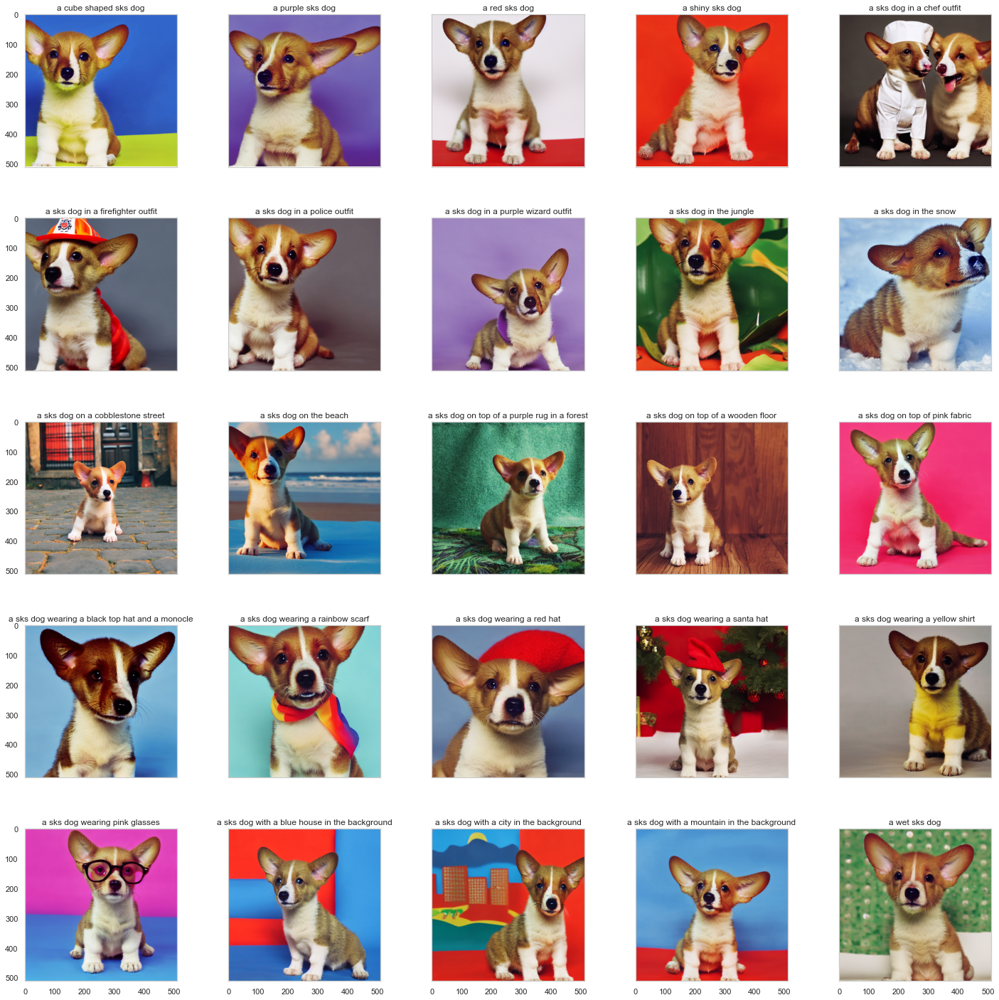

In [16]:
examples = get_examples('../inference/generated_images/dog/t2i/custom_diffusion')
draw_examples(examples)

Concept: backpack

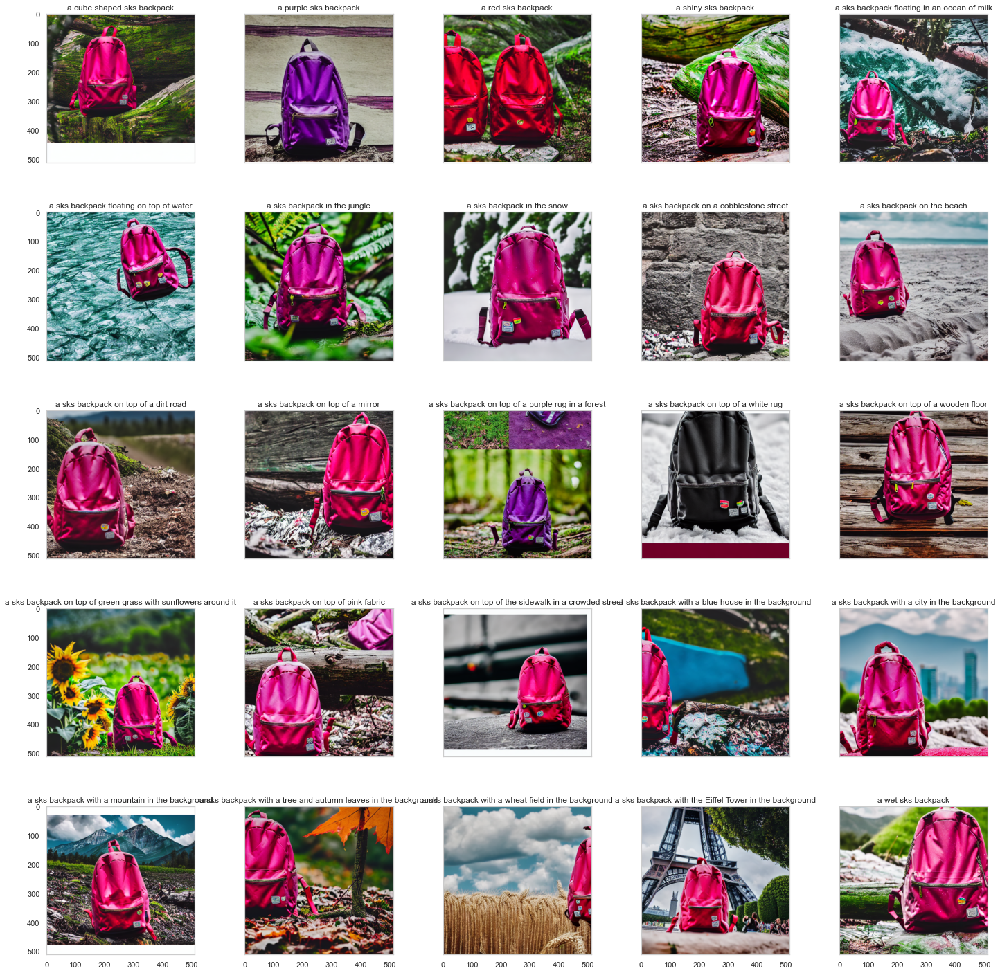

In [17]:
examples = get_examples('../inference/generated_images/backpack/t2i/custom_diffusion')
draw_examples(examples)

Concept: cat

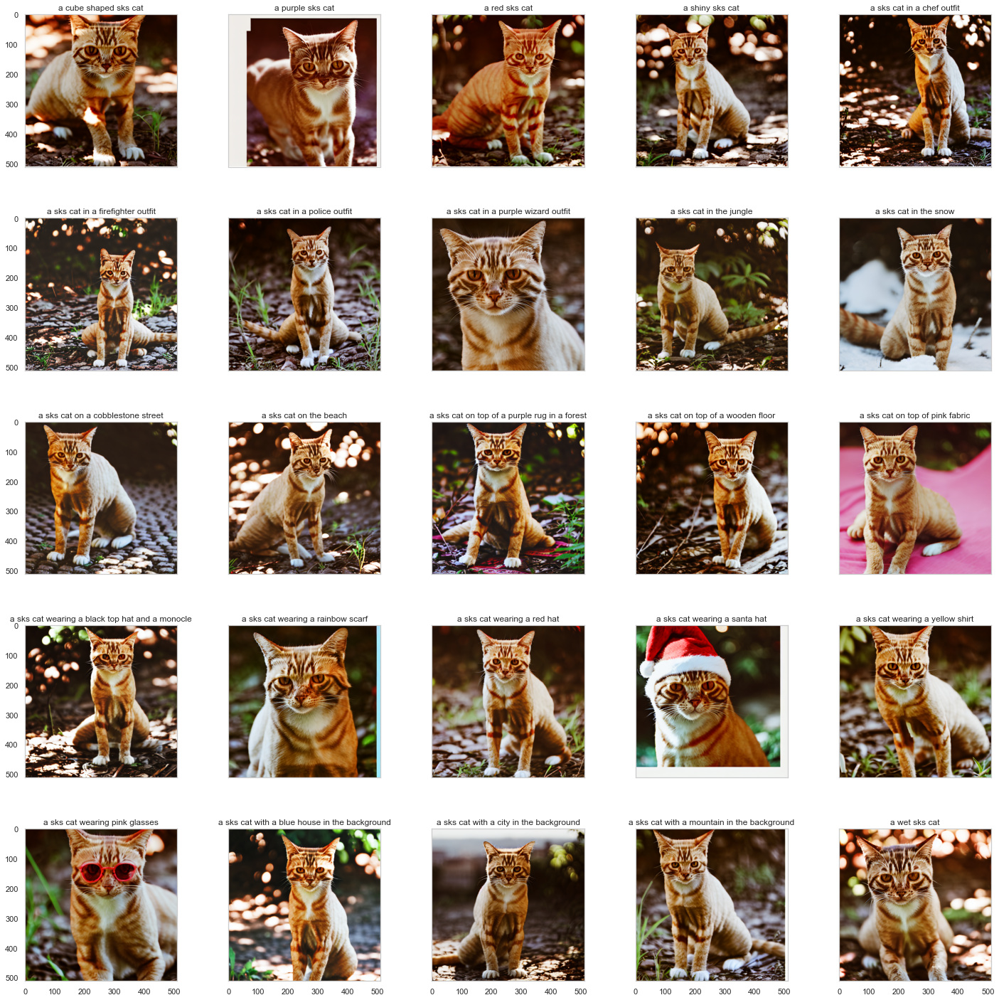

In [18]:
examples = get_examples('../inference/generated_images/cat/t2i/custom_diffusion')
draw_examples(examples)

### SVDiff

Concept: dog6

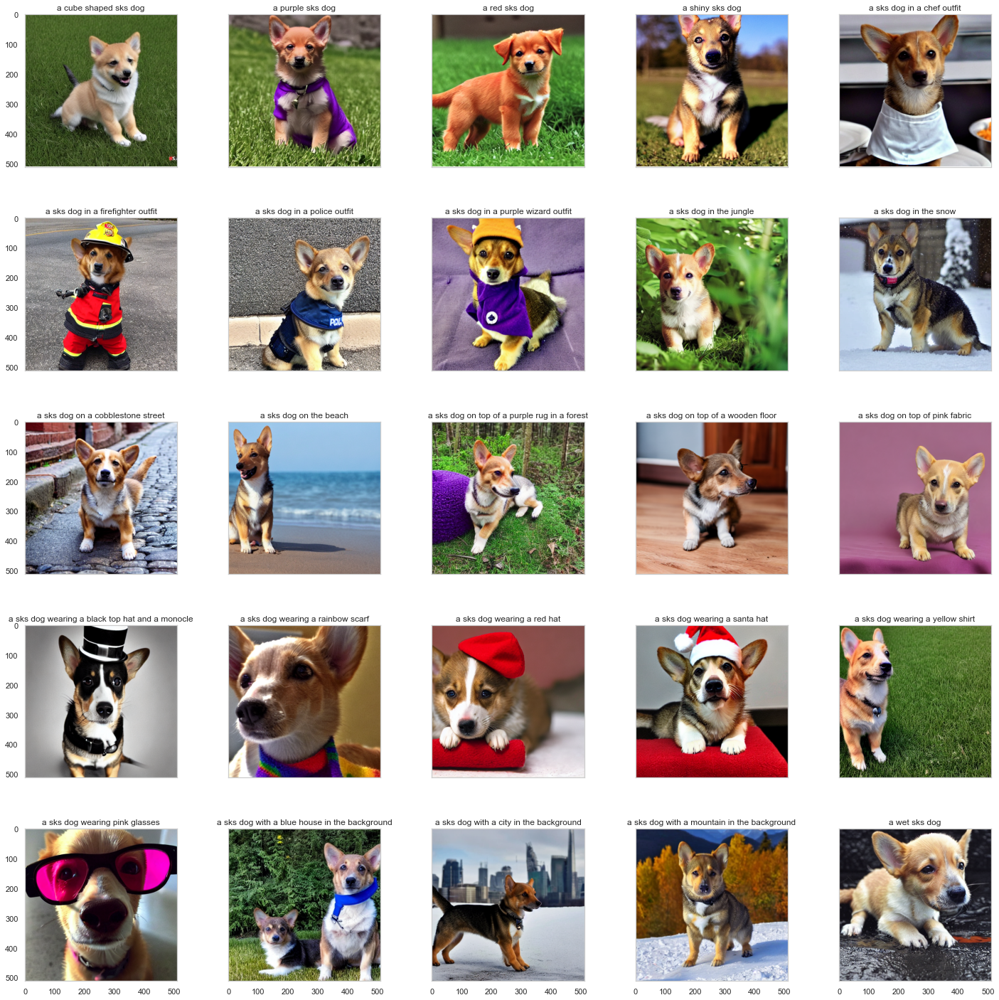

In [19]:
examples = get_examples('../inference/generated_images/dog/t2i/svdiff')
draw_examples(examples)

Concept: backpack

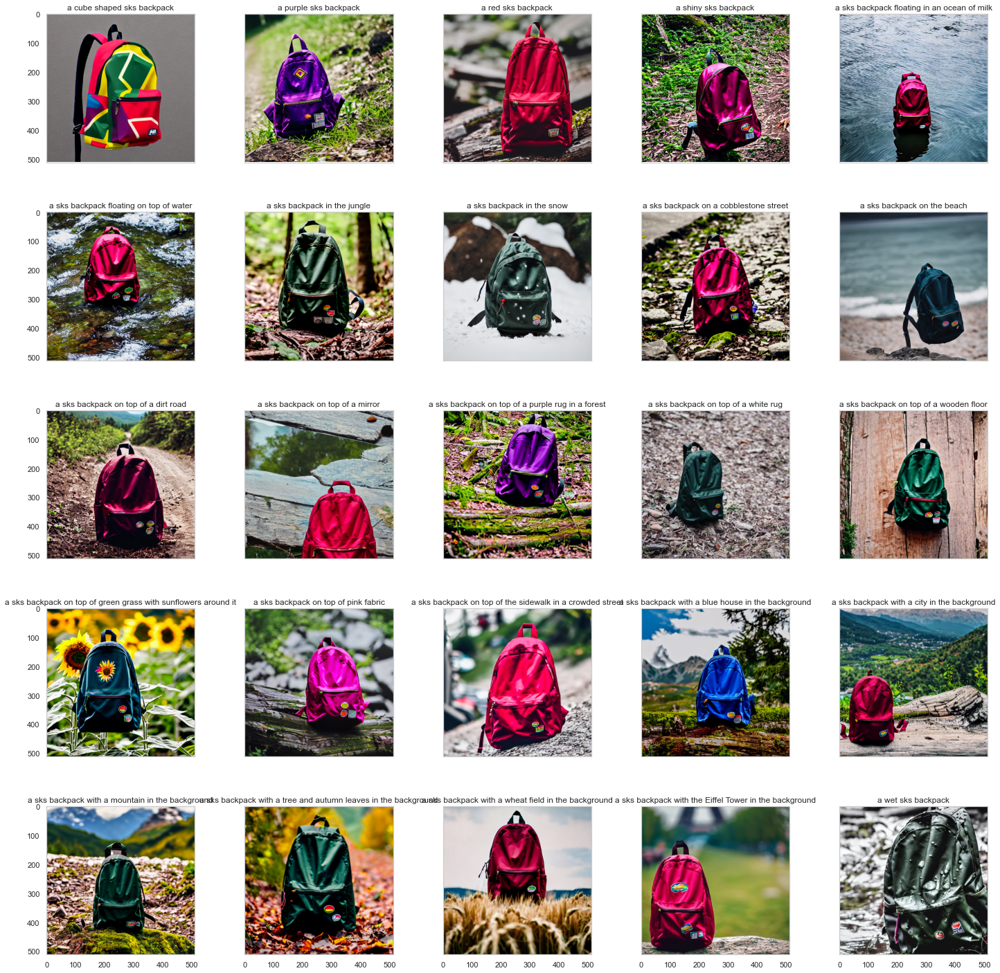

In [20]:
examples = get_examples('../inference/generated_images/backpack/t2i/svdiff')
draw_examples(examples)

Concept: cat

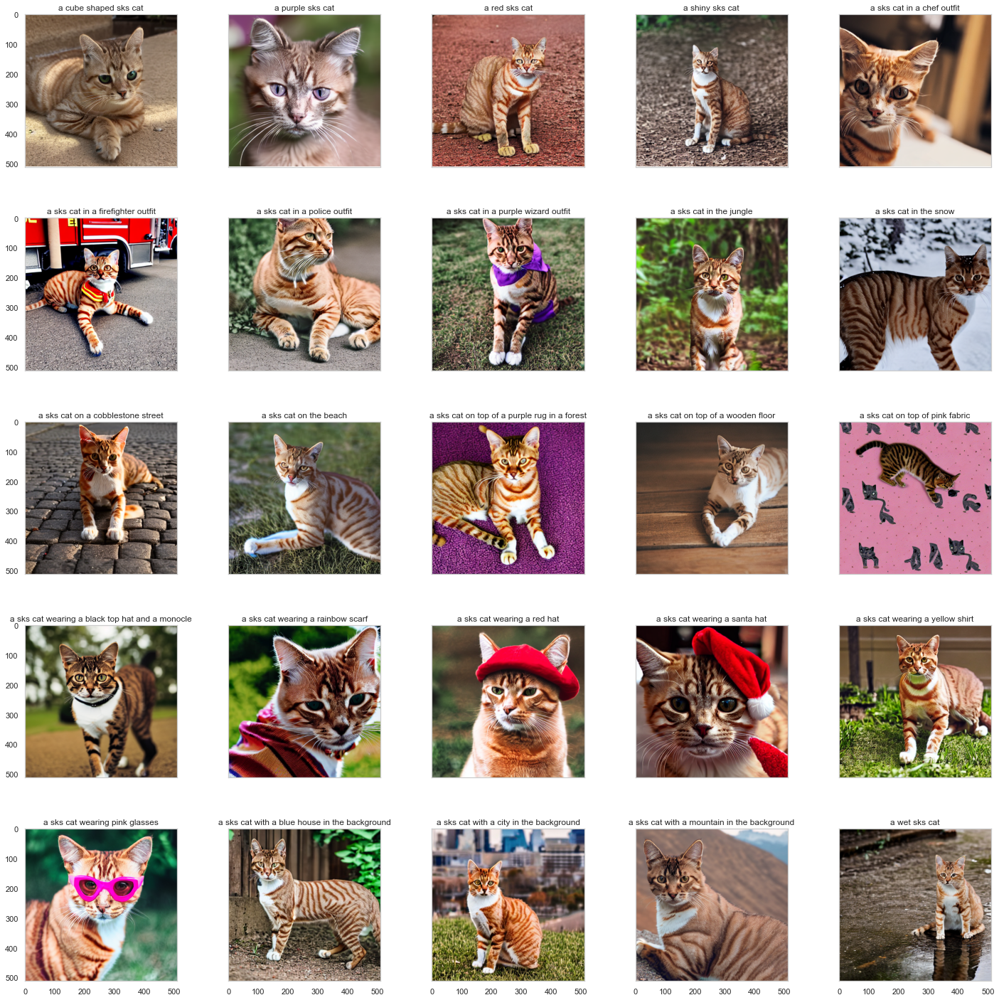

In [21]:
examples = get_examples('../inference/generated_images/cat/t2i/svdiff')
draw_examples(examples)